In [1]:
#Balanced Encoder Decoder 
#BottleNeck: 8

In [2]:
#Disable Warning
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

In [3]:
FILE1 = 'SB-001_normalized_AM.csv'
FILE2 = 'SB-001_normalized_PM.csv'
NO_OF_COLUMNS = 24

In [4]:
#pip install tf2onnx
import tensorflow as tf
from tensorflow import keras
import seaborn as sns
import matplotlib.pyplot as plt
plt.ioff()
import cv2
import IPython
from tqdm import tqdm
import time
import os
import pickle
import pandas as pd
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
warnings.filterwarnings('ignore', message=r'.*Consider either turning off auto-sharding.*')

In [5]:
run_summary = []

In [6]:
def generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers):

    print(encoder_dense_layers, bottle_neck, decoder_dense_layers)
    # Load Data
    df_am = pd.read_csv(FILE1)
    df_pm = pd.read_csv(FILE2)
    combined_df = pd.concat([df_am, df_pm])

    columns_needed = ['y_am_pef', 'tempin', 'humidin', 'pm25in', 'co2in', 'tempdiffin', 'humidiffin', 'pm25diffin',
                      'pm10', 'pm25', 'o3', 'no2', 'co', 'so2', 'temp', 'windsd', 'humid', 'varp', 'dewpt', 'airp',
                      'seap', 'solrhr', 'solramnt', 'grdt', 'class']
    combined_df = combined_df.filter(columns_needed)
    df = combined_df.sample(frac=1, random_state=42).reset_index(drop=True)

    # Drop NaN
    df = df.dropna()

    # Minotity Split
    class_counts = df['class'].value_counts()
    minority_class = df[df['class'] == 0]
    majority_class = df[df['class'] == 1]

    # Removing class column from minority before augmentation
    X = minority_class.drop('class', axis=1)
    y = minority_class['class']

    # Saving minority as X_train
    X_train = X

    # Define the Input shape
    INPUT_SHAPE = X_train.shape[1]
    FILE_NAME = f"L{INPUT_SHAPE}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"
    print("\n" + FILE_NAME + "\n")
    
    def build_autoencoder(input_shape, **kwargs):

        # Autoencoder model construction cod

      """
      Build an autoencoder model with the given configuration.

      Args:
          input_shape (int): The shape of the input data.
          **kwargs: Additional keyword arguments for configuring the autoencoder.

      Keyword Args:
          encoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the encoder.
                                      Default: []
          bottle_neck (int): The number of units in the bottleneck layer. Default: input_shape // 2
          decoder_dense_layers (list): List of integers specifying the number of units for each dense layer in the decoder.
                                      Default: []
          decoder_activation (str): The activation function for the decoder output layer. Default: 'sigmoid'

      Returns:
          tuple: A tuple containing the autoencoder, encoder, and decoder models.

      Example:
          INPUT_SHAPE = 27
          encoder_dense_layers = [20, 18]  # Specify the number of units for each dense layer in the encoder
          bottle_neck = 16
          decoder_dense_layers = [18, 20]  # Specify the number of units for each dense layer in the decoder

          autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                            bottle_neck=bottle_neck, decoder_dense_layers=decoder_dense_layers)
          encoder.summary()
          decoder.summary()
          autoencoder.summary()
      """

      # Default parameter values
      encoder_dense_layers = kwargs.get('encoder_dense_layers', [])
      bottle_neck = kwargs.get('bottle_neck', input_shape // 2)
      decoder_dense_layers = kwargs.get('decoder_dense_layers', [])
      decoder_activation = kwargs.get('decoder_activation', 'sigmoid')

      # Autoencoder Model
      encoder_input = keras.Input(shape=(input_shape,), name="encoder")
      x = keras.layers.Flatten()(encoder_input)

      # Encoder Dense Layers
      for units in encoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      encoder_output = keras.layers.Dense(bottle_neck, activation="relu")(x)
      encoder = keras.Model(encoder_input, encoder_output, name="encoder")

      # Decoder Model
      decoder_input = keras.Input(shape=(bottle_neck,), name="decoder")
      x = decoder_input

      # Decoder Dense Layers
      for units in decoder_dense_layers:
          x = keras.layers.Dense(units, activation="relu")(x)

      decoder_output = keras.layers.Dense(input_shape, activation=decoder_activation)(x)
      decoder = keras.Model(decoder_input, decoder_output, name="decoder")

      # Autoencoder Model
      autoencoder_input = keras.Input(shape=(input_shape,), name="input")
      encoded = encoder(autoencoder_input)
      decoded = decoder(encoded)
      autoencoder = keras.Model(autoencoder_input, decoded, name="autoencoder")

      return autoencoder, encoder, decoder

    autoencoder, encoder, decoder = build_autoencoder(INPUT_SHAPE, encoder_dense_layers=encoder_dense_layers,
                                                      bottle_neck=bottle_neck,
                                                      decoder_dense_layers=decoder_dense_layers)
    opt = keras.optimizers.Adam(learning_rate=0.001)
    autoencoder.compile(opt, loss="mse")

    print("Training model:", FILE_NAME)
    history = autoencoder.fit(X_train, X_train, epochs=200, batch_size=16, validation_split=0.25, verbose=0)
    print("Training Complete:")
    
    # Extract the loss values
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    # Print the last epoch's loss values
    last_epoch_loss = loss[-1]
    last_epoch_val_loss = val_loss[-1]
    print("Last epoch loss:", last_epoch_loss)
    print("Last epoch validation loss:", last_epoch_val_loss)

    # Saving history
    with open(FILE_NAME + '_history.pickle', 'wb') as file:
        pickle.dump(history.history, file)

    # Visualize losses *(MSE)
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(train_loss) + 1)
    plt.plot(epochs, train_loss, 'b', label='Training Loss')
    plt.plot(epochs, val_loss, 'r', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(FILE_NAME + 'Loss.png')
    #plt.show()

    # Generate synthetic data
    num_samples = len(X_train)
    input_data = np.random.normal(size=(num_samples, INPUT_SHAPE))
    generated_data = autoencoder.predict(input_data)
    reshaped_data = generated_data.reshape(num_samples, -1)
    df_generated = pd.DataFrame(reshaped_data, columns=X_train.columns)

    # Plot correlation matrices
    corr_matrix1 = X_train.corr()
    corr_matrix2 = df_generated.corr()

    fig, axes = plt.subplots(1, 2, figsize=(18, 10))
    sns.heatmap(corr_matrix1, annot=True, cmap='coolwarm', ax=axes[0])
    axes[0].set_title('Heatmap 1')

    sns.heatmap(corr_matrix2, annot=True, cmap='coolwarm', ax=axes[1])
    axes[1].set_title('Heatmap 2')

    plt.tight_layout()
    plt.savefig(FILE_NAME + 'HeatMaps')
    #plt.show()

    # Calculate mean and standard deviation of original and synthetic datasets
    common_columns = set(X_train.columns) & set(df_generated.columns)
    results = {}

    for column in common_columns:
        mean_df1 = X_train[column].mean()
        std_df1 = X_train[column].std()
        mean_df2 = df_generated[column].mean()
        std_df2 = df_generated[column].std()

        results[column] = {'Mean_df1': mean_df1, 'Std_df1': std_df1,
                           'Mean_df2': mean_df2, 'Std_df2': std_df2}

    comparison_df = pd.DataFrame(results)
    comparison_df.to_csv(FILE_NAME + 'mean_std.csv', index=True)

    # Plot scatter plots
    new_index = pd.RangeIndex(start=0, stop=57, step=1)
    X_train = X_train.set_index(new_index)
    common_columns = set(X_train.columns) & set(df_generated.columns)

    for column in common_columns:
        plt.scatter(X_train.index, X_train[column], color='red', label='X_train')
        plt.scatter(df_generated.index, df_generated[column], color='blue', label='df_generated')

        plt.title(f"Scatter Plot: {column}")
        plt.xlabel("Index")
        plt.ylabel(column)

        plt.legend()
        plt.savefig(FILE_NAME + "_" + column)
        #plt.show()


    # Add back the class label
    X_train['class'] = 0.0
    df_generated['class'] = 0.0
    X_train.to_csv(FILE_NAME + 'Original_minority_data.csv', index=False)
    df_generated.to_csv(FILE_NAME + 'Synthetic_minority_data.csv', index=False)

    # Generate quality report and display it
    real_data = FILE_NAME + 'Original_minority_data.csv'
    synth_data = FILE_NAME + 'Synthetic_minority_data.csv'

    # report = QualityReport(data_source=synth_data, ref_data=real_data)
    # report.run()

    # print(report.peek())
    #run_summary.append([FILE_NAME, report.peek()['raw_score'], report.peek()['grade']])
    run_summary.append([FILE_NAME, last_epoch_loss, last_epoch_val_loss])

    print("Reports Saved")
    #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))
    return None

In [7]:
# Example usage
def runner(encoder_dense_layers, bottle_neck, decoder_dense_layers):
  #encoder_dense_layers = [10, 8]
  #bottle_neck = 5
  #decoder_dense_layers = [8, 10]
  #FILE_NAME = f"24_{'_'.join(map(str, encoder_dense_layers))}_{bottle_neck}_"
  FILE_NAME = f"L{NO_OF_COLUMNS}_E{'_'.join(map(str, encoder_dense_layers))}_B{bottle_neck}_D{'_'.join(map(str, decoder_dense_layers))}"   
  report = generate_autoencoder_reports(encoder_dense_layers, bottle_neck, decoder_dense_layers)
  #print(type(report))
  # Save the report object to a file
  # with open(FILE_NAME + 'quality_report.pickle', 'wb') as file:
  #     pickle.dump(report, file)

  #IPython.display.HTML(report.as_html, metadata=dict(isolated=True))

In [8]:
# here goes nothin

In [9]:
encoder_dense_layers_trial = [[10, 8], [12, 10], [14, 12], [16, 14], [18, 16], [20, 18] ,[22,20]]
decoder_dense_layers_trial = [[8, 10], [10, 12], [12, 14], [14, 16], [16, 18], [18, 20], [20,22]]
bottle_neck_trial = [8]

In [10]:
total_iterations = len(bottle_neck_trial) * len(encoder_dense_layers_trial) * len(decoder_dense_layers_trial)
print("Total Model in Pipeline:",total_iterations)

# Print total models
for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)

Total Model in Pipeline: 49
[10, 8] 8 [8, 10]
[10, 8] 8 [10, 12]
[10, 8] 8 [12, 14]
[10, 8] 8 [14, 16]
[10, 8] 8 [16, 18]
[10, 8] 8 [18, 20]
[10, 8] 8 [20, 22]
[12, 10] 8 [8, 10]
[12, 10] 8 [10, 12]
[12, 10] 8 [12, 14]
[12, 10] 8 [14, 16]
[12, 10] 8 [16, 18]
[12, 10] 8 [18, 20]
[12, 10] 8 [20, 22]
[14, 12] 8 [8, 10]
[14, 12] 8 [10, 12]
[14, 12] 8 [12, 14]
[14, 12] 8 [14, 16]
[14, 12] 8 [16, 18]
[14, 12] 8 [18, 20]
[14, 12] 8 [20, 22]
[16, 14] 8 [8, 10]
[16, 14] 8 [10, 12]
[16, 14] 8 [12, 14]
[16, 14] 8 [14, 16]
[16, 14] 8 [16, 18]
[16, 14] 8 [18, 20]
[16, 14] 8 [20, 22]
[18, 16] 8 [8, 10]
[18, 16] 8 [10, 12]
[18, 16] 8 [12, 14]
[18, 16] 8 [14, 16]
[18, 16] 8 [16, 18]
[18, 16] 8 [18, 20]
[18, 16] 8 [20, 22]
[20, 18] 8 [8, 10]
[20, 18] 8 [10, 12]
[20, 18] 8 [12, 14]
[20, 18] 8 [14, 16]
[20, 18] 8 [16, 18]
[20, 18] 8 [18, 20]
[20, 18] 8 [20, 22]
[22, 20] 8 [8, 10]
[22, 20] 8 [10, 12]
[22, 20] 8 [12, 14]
[22, 20] 8 [14, 16]
[22, 20] 8 [16, 18]
[22, 20] 8 [18, 20]
[22, 20] 8 [20, 22]


[10, 8] 8 [8, 10]
[10, 8] 8 [8, 10]

L24_E10_8_B8_D8_10

Training model: L24_E10_8_B8_D8_10
Training Complete:
Last epoch loss: 0.014485765248537064
Last epoch validation loss: 0.022974494844675064
Reports Saved
[10, 8] 8 [10, 12]
[10, 8] 8 [10, 12]

L24_E10_8_B8_D10_12

Training model: L24_E10_8_B8_D10_12
Training Complete:
Last epoch loss: 0.01060680951923132
Last epoch validation loss: 0.017263062298297882
Reports Saved
[10, 8] 8 [12, 14]
[10, 8] 8 [12, 14]

L24_E10_8_B8_D12_14

Training model: L24_E10_8_B8_D12_14
Training Complete:
Last epoch loss: 0.01191693264991045
Last epoch validation loss: 0.018185237422585487
Reports Saved
[10, 8] 8 [14, 16]
[10, 8] 8 [14, 16]

L24_E10_8_B8_D14_16

Training model: L24_E10_8_B8_D14_16
Training Complete:
Last epoch loss: 0.01197029184550047
Last epoch validation loss: 0.019739432260394096
Reports Saved
[10, 8] 8 [16, 18]
[10, 8] 8 [16, 18]

L24_E10_8_B8_D16_18

Training model: L24_E10_8_B8_D16_18
Training Complete:
Last epoch loss: 0.019925586

Reports Saved
[12, 10] 8 [18, 20]
[12, 10] 8 [18, 20]

L24_E12_10_B8_D18_20

Training model: L24_E12_10_B8_D18_20
Training Complete:
Last epoch loss: 0.00894559733569622
Last epoch validation loss: 0.014437427744269371
Reports Saved
[12, 10] 8 [20, 22]
[12, 10] 8 [20, 22]

L24_E12_10_B8_D20_22

Training model: L24_E12_10_B8_D20_22
Training Complete:
Last epoch loss: 0.01231972686946392
Last epoch validation loss: 0.018815921619534492
Reports Saved
[14, 12] 8 [8, 10]
[14, 12] 8 [8, 10]

L24_E14_12_B8_D8_10

Training model: L24_E14_12_B8_D8_10
Training Complete:
Last epoch loss: 0.012731770984828472
Last epoch validation loss: 0.021036537364125252
Reports Saved
[14, 12] 8 [10, 12]
[14, 12] 8 [10, 12]

L24_E14_12_B8_D10_12

Training model: L24_E14_12_B8_D10_12
Training Complete:
Last epoch loss: 0.01113224495202303
Last epoch validation loss: 0.017919274047017097
Reports Saved
[14, 12] 8 [12, 14]
[14, 12] 8 [12, 14]

L24_E14_12_B8_D12_14

Training model: L24_E14_12_B8_D12_14
Training Comp

Reports Saved
[16, 14] 8 [8, 10]
[16, 14] 8 [8, 10]

L24_E16_14_B8_D8_10

Training model: L24_E16_14_B8_D8_10
Training Complete:
Last epoch loss: 0.015016626566648483
Last epoch validation loss: 0.022679856047034264
Reports Saved
[16, 14] 8 [10, 12]
[16, 14] 8 [10, 12]

L24_E16_14_B8_D10_12

Training model: L24_E16_14_B8_D10_12
Training Complete:
Last epoch loss: 0.013373789377510548
Last epoch validation loss: 0.019602077081799507
Reports Saved
[16, 14] 8 [12, 14]
[16, 14] 8 [12, 14]

L24_E16_14_B8_D12_14

Training model: L24_E16_14_B8_D12_14
Training Complete:
Last epoch loss: 0.012410826981067657
Last epoch validation loss: 0.01914897747337818
Reports Saved
[16, 14] 8 [14, 16]
[16, 14] 8 [14, 16]

L24_E16_14_B8_D14_16

Training model: L24_E16_14_B8_D14_16
Training Complete:
Last epoch loss: 0.011969251558184624
Last epoch validation loss: 0.01774691417813301
Reports Saved
[16, 14] 8 [16, 18]
[16, 14] 8 [16, 18]

L24_E16_14_B8_D16_18

Training model: L24_E16_14_B8_D16_18
Training Com

Reports Saved
[18, 16] 8 [12, 14]
[18, 16] 8 [12, 14]

L24_E18_16_B8_D12_14

Training model: L24_E18_16_B8_D12_14
Training Complete:
Last epoch loss: 0.011286692693829536
Last epoch validation loss: 0.018138177692890167
Reports Saved
[18, 16] 8 [14, 16]
[18, 16] 8 [14, 16]

L24_E18_16_B8_D14_16

Training model: L24_E18_16_B8_D14_16
Training Complete:
Last epoch loss: 0.010196437127888203
Last epoch validation loss: 0.016214074566960335
Reports Saved
[18, 16] 8 [16, 18]
[18, 16] 8 [16, 18]

L24_E18_16_B8_D16_18

Training model: L24_E18_16_B8_D16_18
Training Complete:
Last epoch loss: 0.009142173454165459
Last epoch validation loss: 0.014627589844167233
Reports Saved
[18, 16] 8 [18, 20]
[18, 16] 8 [18, 20]

L24_E18_16_B8_D18_20

Training model: L24_E18_16_B8_D18_20
Training Complete:
Last epoch loss: 0.00772350188344717
Last epoch validation loss: 0.01263710018247366
Reports Saved
[18, 16] 8 [20, 22]
[18, 16] 8 [20, 22]

L24_E18_16_B8_D20_22

Training model: L24_E18_16_B8_D20_22
Training

Reports Saved
[20, 18] 8 [16, 18]
[20, 18] 8 [16, 18]

L24_E20_18_B8_D16_18

Training model: L24_E20_18_B8_D16_18
Training Complete:
Last epoch loss: 0.010552365332841873
Last epoch validation loss: 0.0183887779712677
Reports Saved
[20, 18] 8 [18, 20]
[20, 18] 8 [18, 20]

L24_E20_18_B8_D18_20

Training model: L24_E20_18_B8_D18_20
Training Complete:
Last epoch loss: 0.011967958882451057
Last epoch validation loss: 0.018513737246394157
Reports Saved
[20, 18] 8 [20, 22]
[20, 18] 8 [20, 22]

L24_E20_18_B8_D20_22

Training model: L24_E20_18_B8_D20_22
Training Complete:
Last epoch loss: 0.008885313756763935
Last epoch validation loss: 0.014631390571594238
Reports Saved
[22, 20] 8 [8, 10]
[22, 20] 8 [8, 10]

L24_E22_20_B8_D8_10

Training model: L24_E22_20_B8_D8_10
Training Complete:
Last epoch loss: 0.015228407457470894
Last epoch validation loss: 0.026589354500174522
Reports Saved
[22, 20] 8 [10, 12]
[22, 20] 8 [10, 12]

L24_E22_20_B8_D10_12

Training model: L24_E22_20_B8_D10_12
Training Com

Reports Saved
[22, 20] 8 [20, 22]
[22, 20] 8 [20, 22]

L24_E22_20_B8_D20_22

Training model: L24_E22_20_B8_D20_22
Training Complete:
Last epoch loss: 0.009280879981815815
Last epoch validation loss: 0.016958439722657204
Reports Saved
Total time: 48.37037213643392 minutes


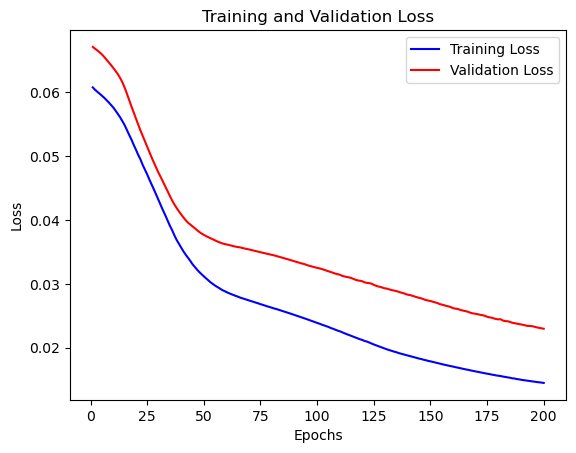

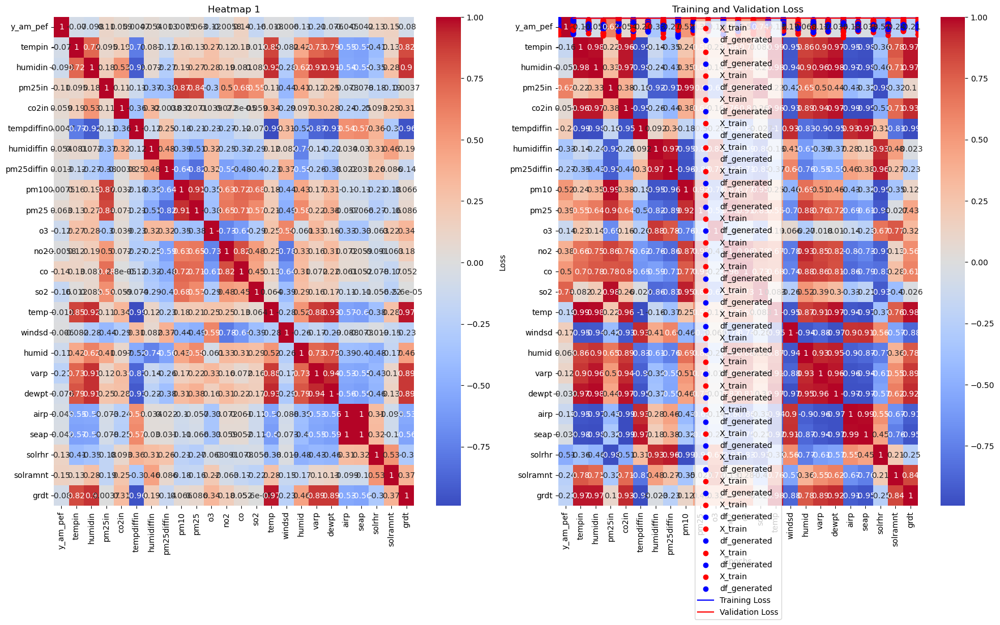

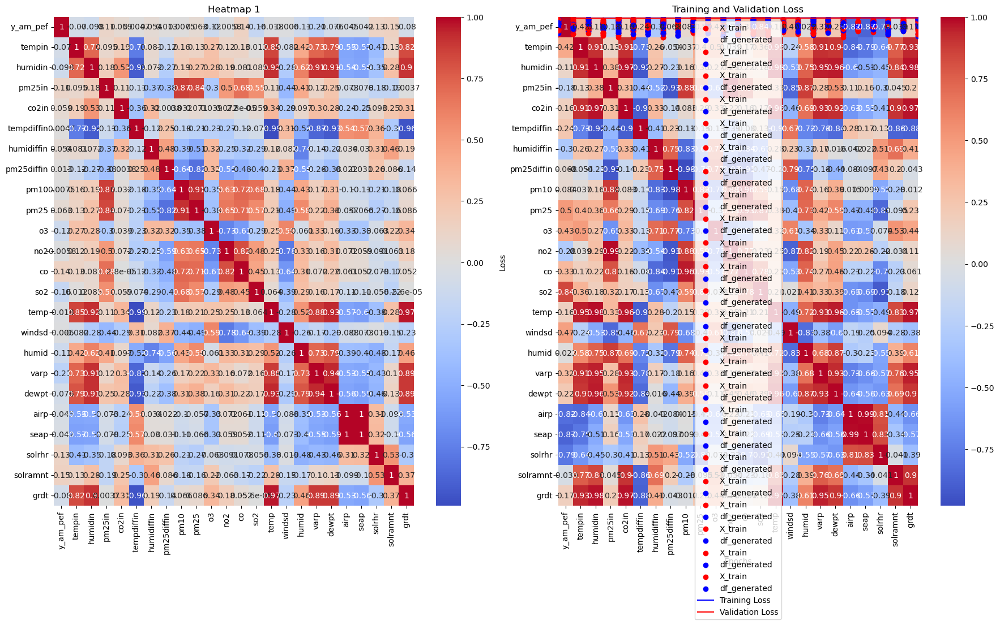

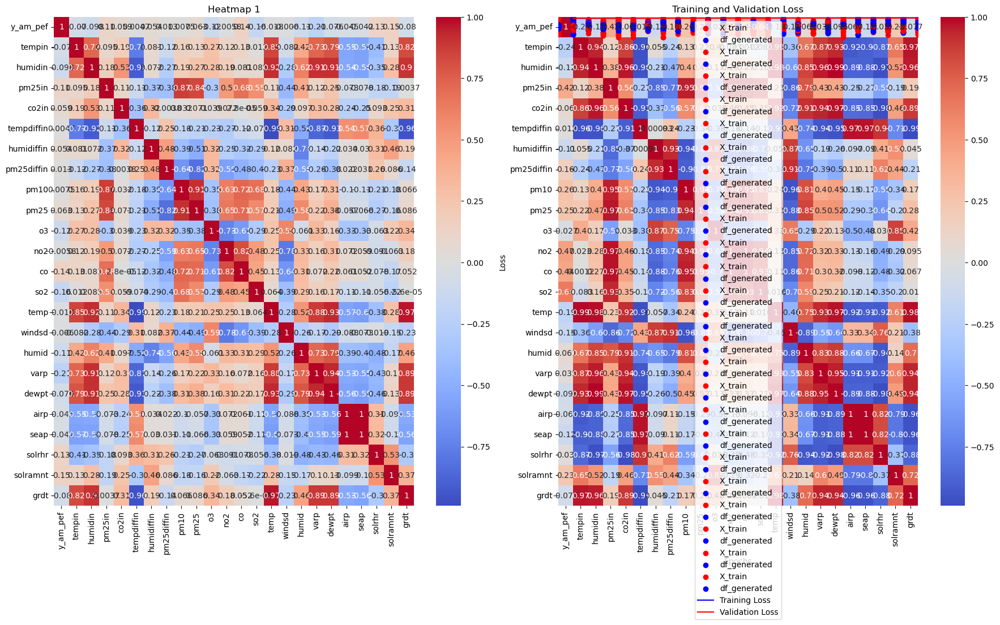

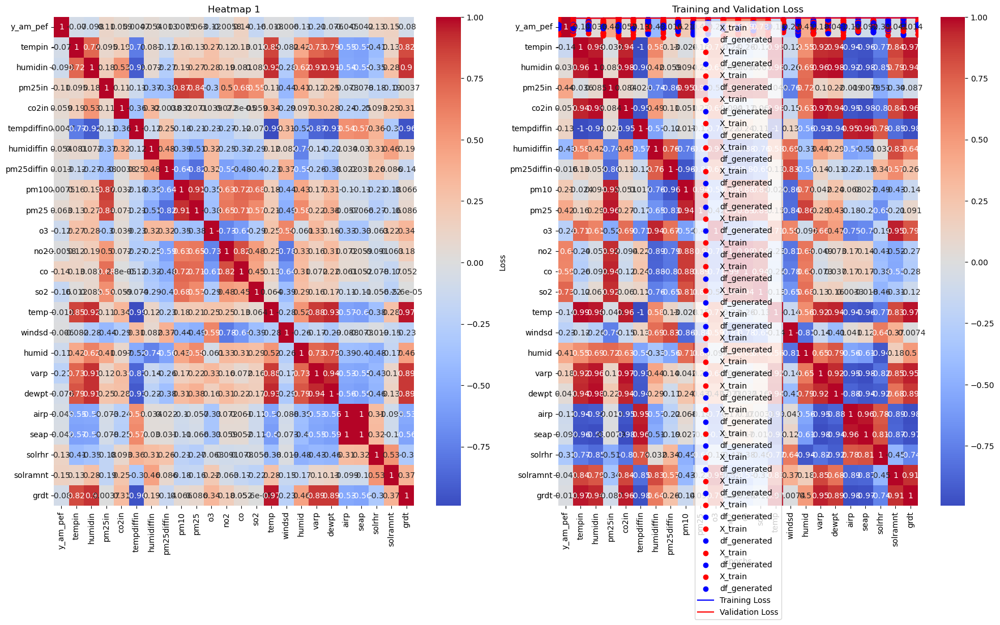

...

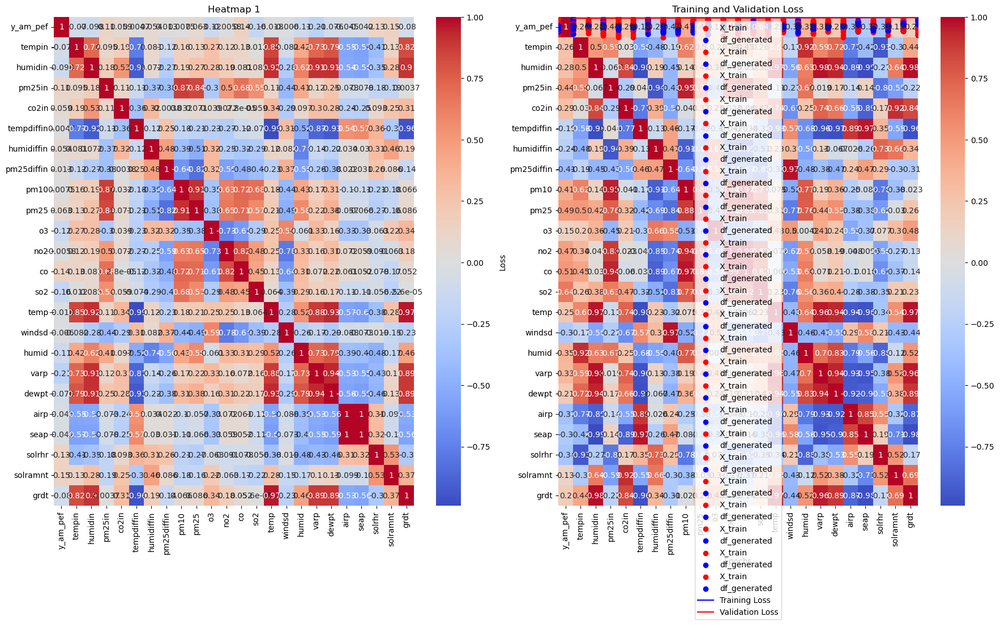

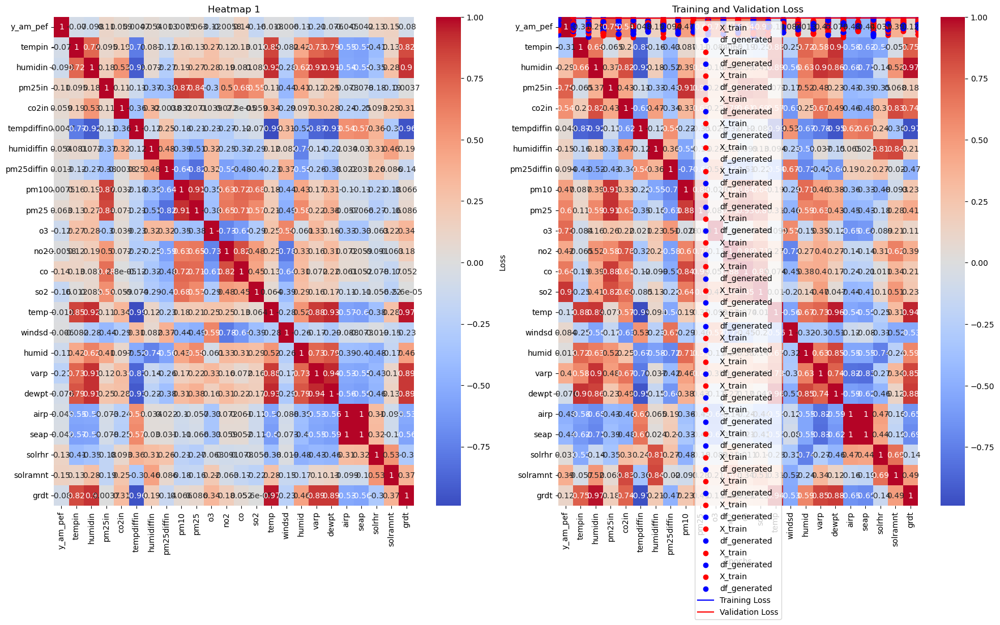

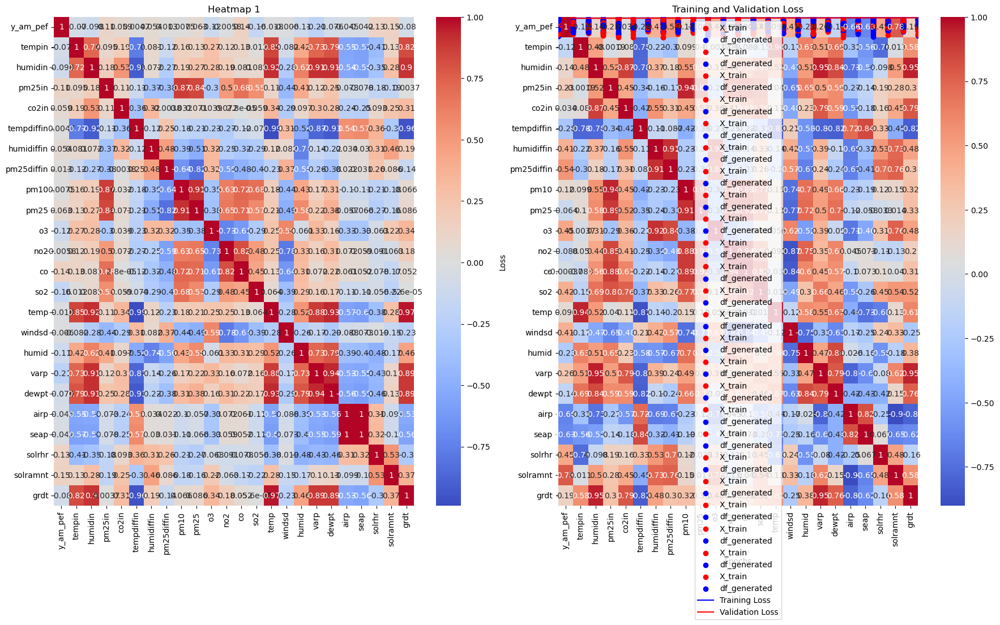

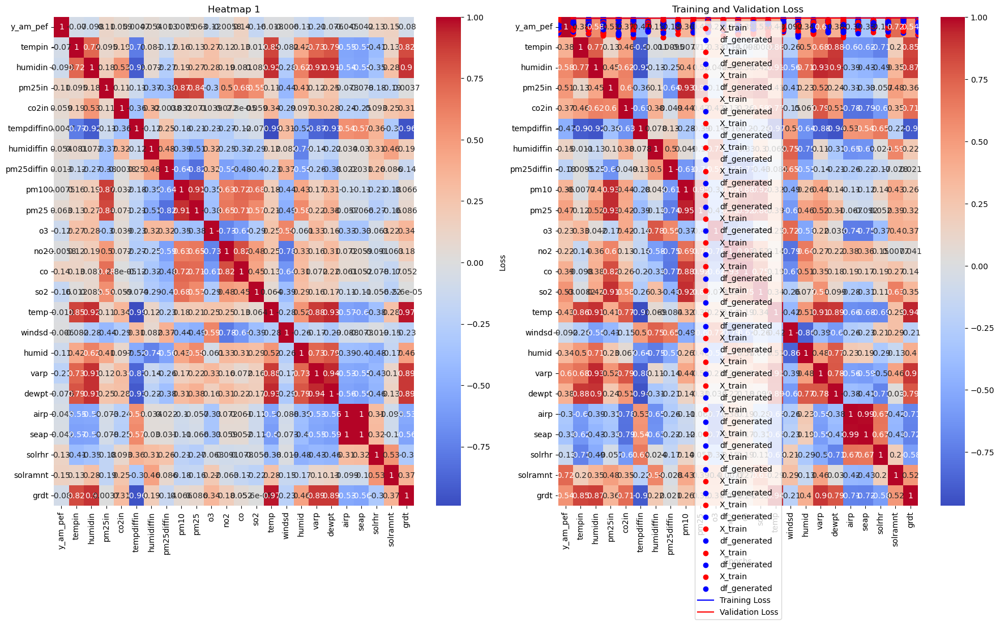

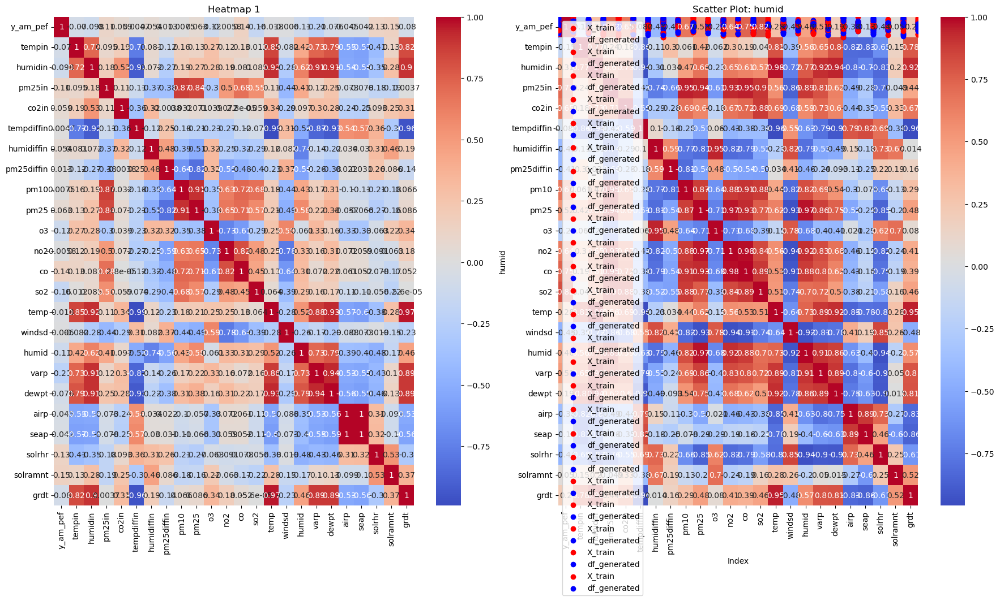

In [11]:
start_time = time.time()

for bn in bottle_neck_trial:
  for enc_layers in encoder_dense_layers_trial:
      for dec_layers in decoder_dense_layers_trial:
          print(enc_layers, bn, dec_layers)
          runner(enc_layers, bn, dec_layers)
                
end_time = time.time()
total_time = end_time - start_time                
total_time_minutes = total_time / 60
print(f"Total time: {total_time_minutes} minutes") 

In [12]:
print(run_summary)

[['L24_E10_8_B8_D8_10', 0.014485765248537064, 0.022974494844675064], ['L24_E10_8_B8_D10_12', 0.01060680951923132, 0.017263062298297882], ['L24_E10_8_B8_D12_14', 0.01191693264991045, 0.018185237422585487], ['L24_E10_8_B8_D14_16', 0.01197029184550047, 0.019739432260394096], ['L24_E10_8_B8_D16_18', 0.019925586879253387, 0.030561503022909164], ['L24_E10_8_B8_D18_20', 0.010648761875927448, 0.01723061129450798], ['L24_E10_8_B8_D20_22', 0.008817360736429691, 0.01468233484774828], ['L24_E12_10_B8_D8_10', 0.019411494955420494, 0.029249368235468864], ['L24_E12_10_B8_D10_12', 0.01750911958515644, 0.026244964450597763], ['L24_E12_10_B8_D12_14', 0.010249115526676178, 0.016656721010804176], ['L24_E12_10_B8_D14_16', 0.013395854271948338, 0.020195357501506805], ['L24_E12_10_B8_D16_18', 0.011268990114331245, 0.01946195401251316], ['L24_E12_10_B8_D18_20', 0.00894559733569622, 0.014437427744269371], ['L24_E12_10_B8_D20_22', 0.01231972686946392, 0.018815921619534492], ['L24_E14_12_B8_D8_10', 0.01273177098

In [14]:
import csv
#save run_summary as a file
filename = 'run_summary.csv'

with open(filename, 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(run_summary)

print(f"Run summary has saved: {filename}")

Run summary has saved: run_summary.csv


In [15]:
run_summary.sort(key=lambda x: x[1], reverse=True)  # Sort by the middle value in descending order

top_10 = run_summary[:10]  # Get the top 10 elements

for item in top_10:
    print(item)

['L24_E10_8_B8_D16_18', 0.019925586879253387, 0.030561503022909164]
['L24_E12_10_B8_D8_10', 0.019411494955420494, 0.029249368235468864]
['L24_E18_16_B8_D8_10', 0.019272297620773315, 0.02741379849612713]
['L24_E18_16_B8_D10_12', 0.018363693729043007, 0.027087045833468437]
['L24_E12_10_B8_D10_12', 0.01750911958515644, 0.026244964450597763]
['L24_E18_16_B8_D20_22', 0.016000131145119667, 0.03169606253504753]
['L24_E22_20_B8_D8_10', 0.015228407457470894, 0.026589354500174522]
['L24_E16_14_B8_D8_10', 0.015016626566648483, 0.022679856047034264]
['L24_E10_8_B8_D8_10', 0.014485765248537064, 0.022974494844675064]
['L24_E14_12_B8_D12_14', 0.013684283010661602, 0.020270029082894325]


In [16]:
for item in run_summary:
    print(item)

['L24_E10_8_B8_D16_18', 0.019925586879253387, 0.030561503022909164]
['L24_E12_10_B8_D8_10', 0.019411494955420494, 0.029249368235468864]
['L24_E18_16_B8_D8_10', 0.019272297620773315, 0.02741379849612713]
['L24_E18_16_B8_D10_12', 0.018363693729043007, 0.027087045833468437]
['L24_E12_10_B8_D10_12', 0.01750911958515644, 0.026244964450597763]
['L24_E18_16_B8_D20_22', 0.016000131145119667, 0.03169606253504753]
['L24_E22_20_B8_D8_10', 0.015228407457470894, 0.026589354500174522]
['L24_E16_14_B8_D8_10', 0.015016626566648483, 0.022679856047034264]
['L24_E10_8_B8_D8_10', 0.014485765248537064, 0.022974494844675064]
['L24_E14_12_B8_D12_14', 0.013684283010661602, 0.020270029082894325]
['L24_E12_10_B8_D14_16', 0.013395854271948338, 0.020195357501506805]
['L24_E16_14_B8_D10_12', 0.013373789377510548, 0.019602077081799507]
['L24_E14_12_B8_D8_10', 0.012731770984828472, 0.021036537364125252]
['L24_E20_18_B8_D8_10', 0.012469247914850712, 0.01866072788834572]
['L24_E16_14_B8_D12_14', 0.012410826981067657, 